In [1]:
import rioxarray as rx
import xarray as xr
import seaborn as sns
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (8,6)
plt.rcParams['figure.dpi'] = 300
plt.rcParams['font.family'] = ['Times New Roman + SimSun + Nowar Sans GB18030', ]  # 设置字体 simhei, Heiti TC
font_name = "Times New Roman + SimSun + Nowar Sans GB18030"

In [2]:
import os
os.chdir(r"/Volumes/2TMyRes/SynologyDrive/SCI/BeijingHeatExposure")

In [3]:
import matplotlib.pylab as pl
import numpy as np
import xgboost
from sklearn.model_selection import train_test_split
import joblib
import shap
import xgboost as xgb
# print the JS visualization code to the notebook
# shap.initjs()

import joblib

In [4]:
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, root_mean_squared_error, mean_absolute_error
from sklearn.metrics import r2_score

from sklearn.model_selection import GridSearchCV, cross_validate

# data

In [5]:
tmp = './LST/Downscaled_LST_usingS2_10m.tif'
ndvi = './NDVI/ndvi_2020-08.tif'
dem = './DEM/北京市_DEM_30m分辨率_SRTM数据.tif'
tmp = rx.open_rasterio(tmp)
ndvi = rx.open_rasterio(ndvi)
ndvi = ndvi / 10000
dem = rx.open_rasterio(dem)
lc = rx.open_rasterio('./其他数据/1M地覆数据/lc_5ring.tif')

In [6]:
ring2 = gpd.read_file('./边界数据/北京六环/二环.shp')
ring3 = gpd.read_file('./边界数据/北京六环/三环.shp')
ring4 = gpd.read_file('./边界数据/北京六环/四环.shp')
ring5 = gpd.read_file('./边界数据/北京六环/五环.shp')

In [7]:
region = './边界数据/研究区/五环.shp'
region = gpd.read_file(region)

In [8]:
tmp.rio.transform()

Affine(8.983152841195215e-05, 0.0, 116.16159854713739,
       0.0, -8.983152841195215e-05, 40.04833267050286)

In [9]:
ndvi.rio.transform()

Affine(8.983152841195215e-05, 0.0, 115.99118813773991,
       0.0, -8.983152841195215e-05, 40.222516004093634)

In [10]:
dem.rio.transform()

Affine(0.0002777777777777773, 0.0, 115.41736111111112,
       0.0, -0.0002777777777777773, 41.05930555555556)

In [11]:
lc.rio.transform()

Affine(1.0728836062488446e-05, 0.0, 116.201802492,
       0.0, -1.0728836069550953e-05, 40.021970272)

In [12]:
base_reso = 8.983152841195215e-05

In [13]:
from rasterio.crs import CRS

In [14]:
print(dem.rio.resolution())
print(lc.rio.resolution())

(0.0002777777777777773, -0.0002777777777777773)
(1.0728836062488446e-05, -1.0728836069550953e-05)


In [15]:
dem_reso = dem.rio.reproject(CRS.from_epsg(4326), resolution=(base_reso, base_reso))
lc_reso = lc.rio.reproject(CRS.from_epsg(4326), resolution=(base_reso, base_reso))

In [16]:
dem_reso.rio.transform()

Affine(8.983152841195215e-05, 0.0, 115.41736111111112,
       0.0, -8.983152841195215e-05, 41.05930555555556)

In [17]:
lc_reso.rio.transform()

Affine(8.983152841195215e-05, 0.0, 116.201802492,
       0.0, -8.983152841195215e-05, 40.021970272)

In [18]:
lc_reso

<xarray.DataArray (band: 1, y: 2954, x: 3808)> Size: 11MB
array([[[2, 2, 2, ..., 2, 2, 0],
        [2, 2, 2, ..., 2, 2, 0],
        [2, 2, 2, ..., 6, 2, 0],
        ...,
        [6, 6, 6, ..., 6, 6, 0],
        [6, 6, 6, ..., 6, 6, 0],
        [6, 6, 6, ..., 1, 1, 0]]], dtype=uint8)
Coordinates:
  * x            (x) float64 30kB 116.2 116.2 116.2 116.2 ... 116.5 116.5 116.5
  * y            (y) float64 24kB 40.02 40.02 40.02 40.02 ... 39.76 39.76 39.76
  * band         (band) int64 8B 1
    spatial_ref  int64 8B 0
Attributes:
    AREA_OR_POINT:  Area
    scale_factor:   1.0
    add_offset:     0.0
    _FillValue:     0

# clip

In [19]:
tmp = tmp.rio.clip(region.geometry)
dem = dem_reso.rio.clip(region.geometry)
dem = dem.where(dem!=0, np.nan)
lc = lc_reso.rio.clip(region.geometry)
lc = lc.where(lc!=0, np.nan)
ndvi = ndvi.rio.clip(region.geometry)

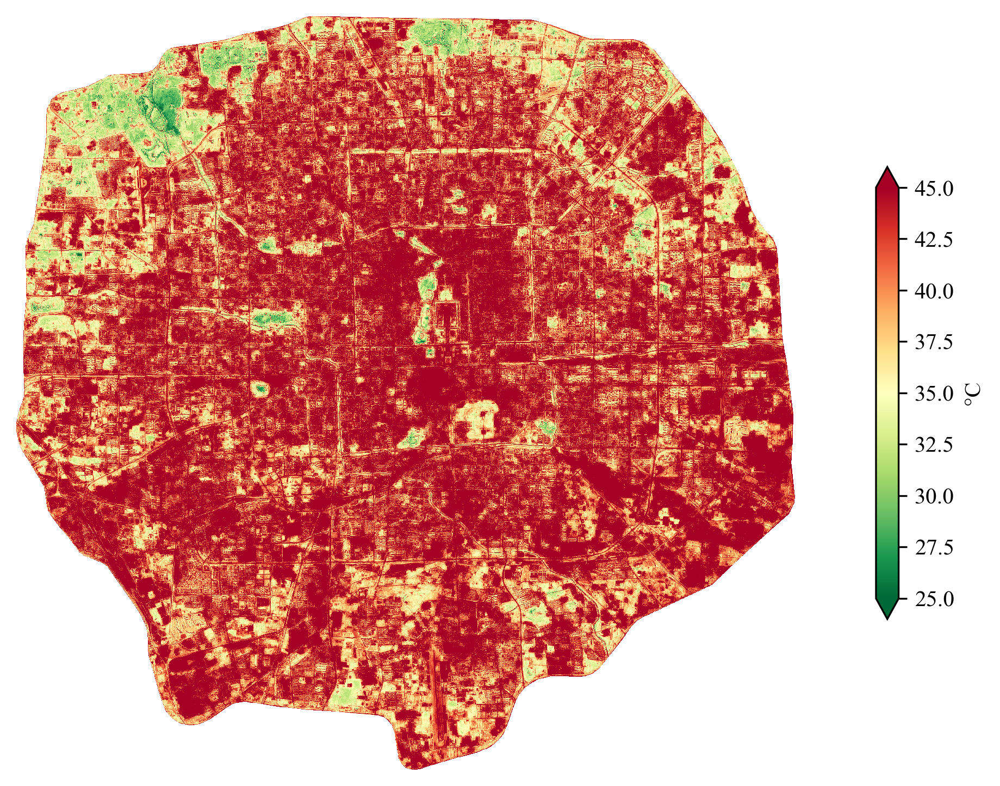

In [68]:
fig, ax = plt.subplots(dpi=300)
tmp.plot(vmin=25, vmax=45, cmap='RdYlGn_r', ax=ax,
        cbar_kwargs={'shrink': 0.6, 'label': '°C', 'pad': 0.08}
        )
ax.axis('off')
ax.set_title('')
plt.savefig(f'./SavedFig3/LST.png', bbox_inches='tight',dpi=300)

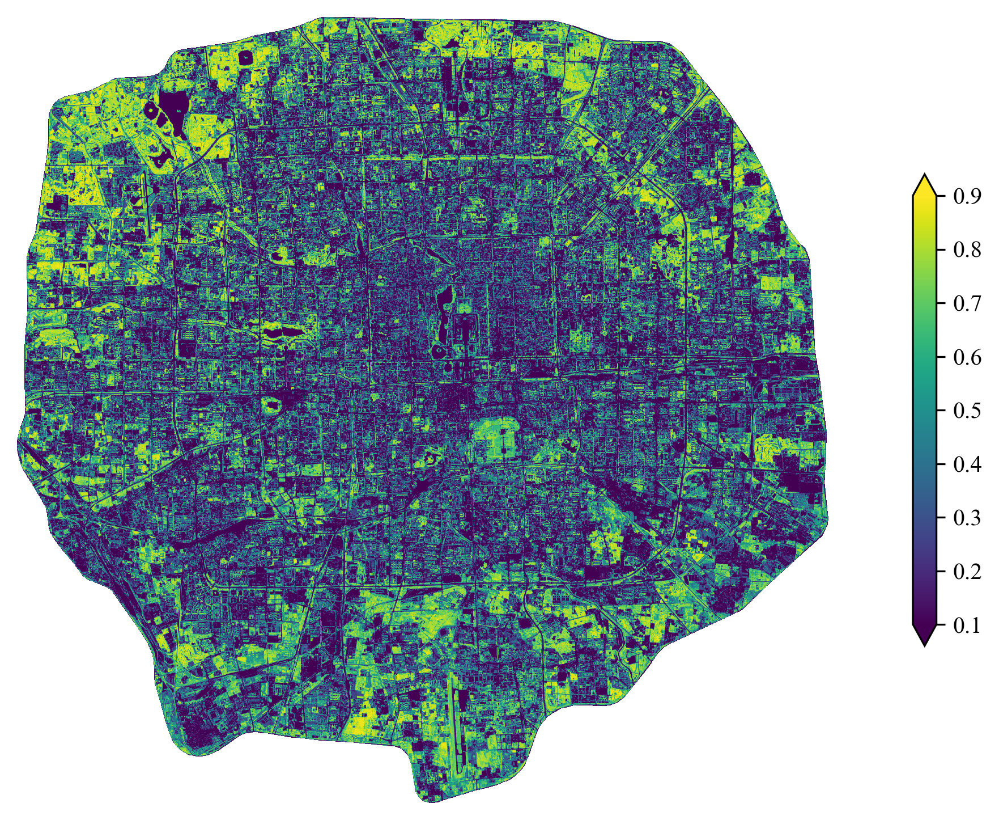

In [65]:
fig, ax = plt.subplots(dpi=300)
ndvi.plot(vmin=.1, vmax=.9, 
         cbar_kwargs={'shrink': 0.6, 'label': '', 'pad': 0.08}
         )
ax.axis('off')
ax.set_title('')
plt.savefig(f'./SavedFig3/NDVI.png', bbox_inches='tight',dpi=300)

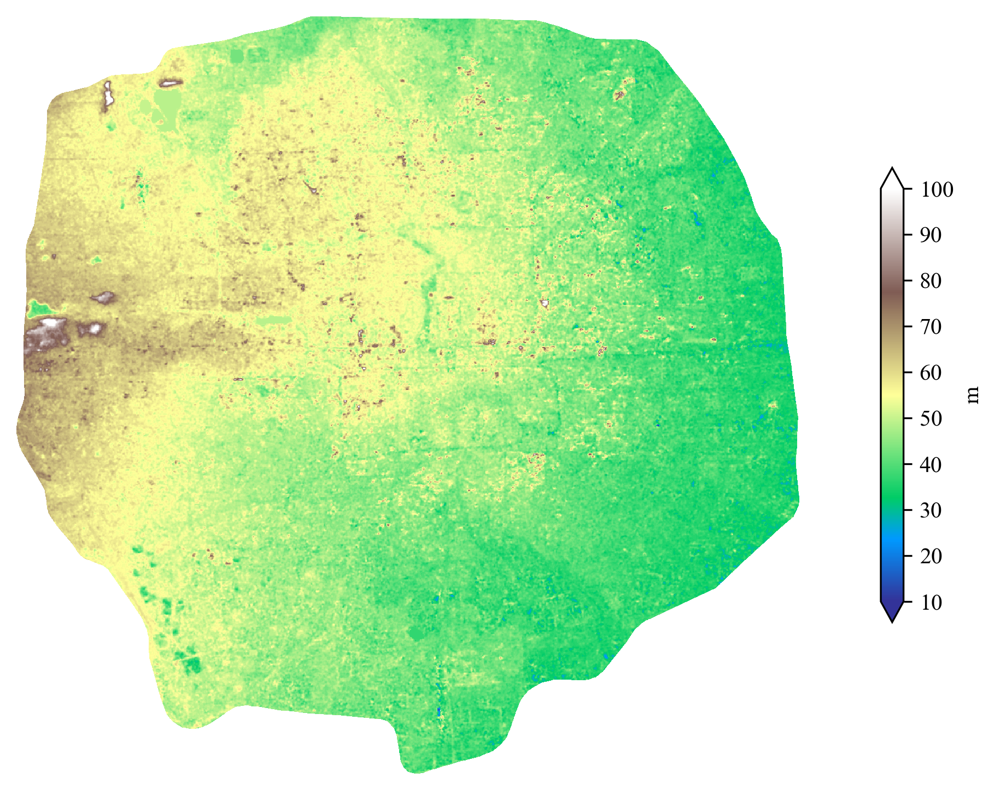

In [66]:
fig, ax = plt.subplots(dpi=300)

import matplotlib.colors as colors
colors_undersea = plt.cm.terrain(np.linspace(0, 0.17, 256))
colors_land = plt.cm.terrain(np.linspace(0.25, 1, 256))
all_colors = np.vstack((colors_undersea, colors_land))
terrain_map = colors.LinearSegmentedColormap.from_list(
    'terrain_map', all_colors)


dem.plot(vmin=10, vmax=100,  cmap='terrain',
        cbar_kwargs={'shrink': 0.6, 'label': 'm', 'pad': 0.08}
        )
ax.axis('off')
ax.set_title('')
plt.savefig(f'./SavedFig3/DEM.png', bbox_inches='tight',dpi=300)

In [23]:
# lc.plot()

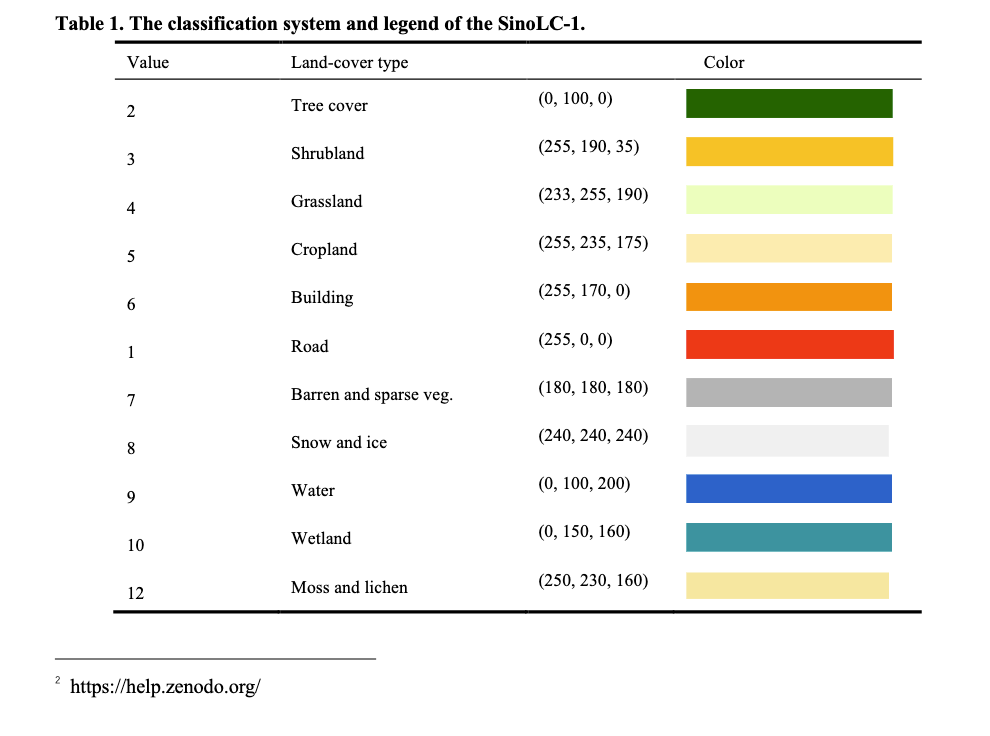

Text(0.5, 1.0, '')

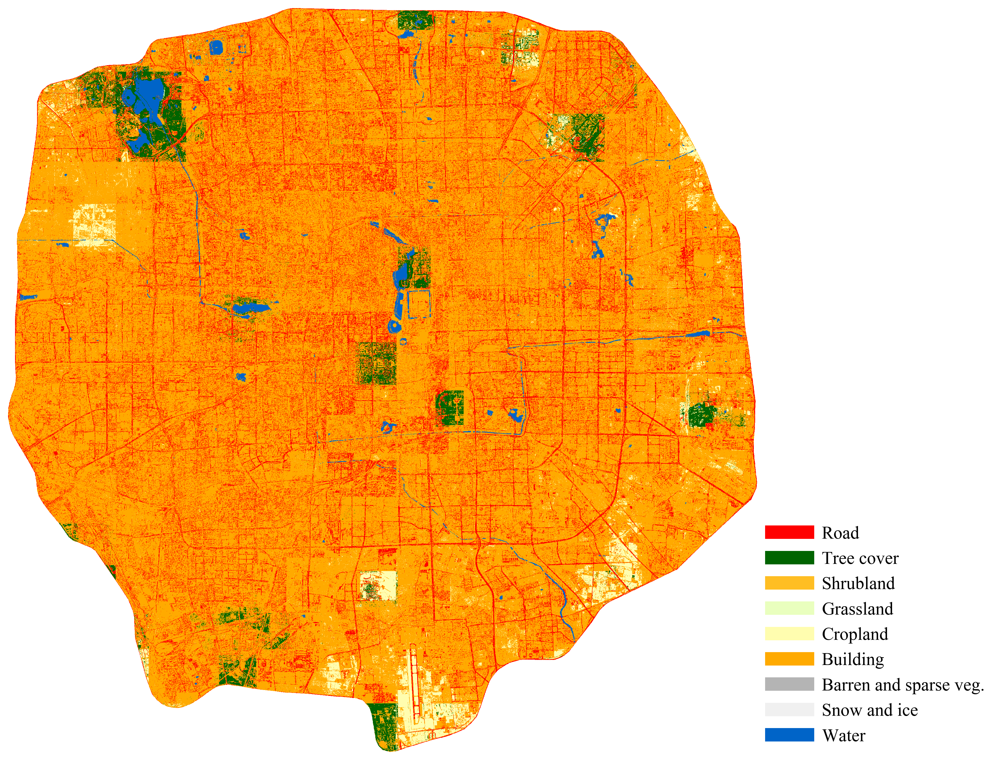

In [24]:
from matplotlib.colors import BoundaryNorm, ListedColormap

boundaries = [1, 2, 3, 4, 5, 6, 7, 8, 9]
colors = [
    np.array([255,0,0])/255, # 1. Road
    np.array([0,100,0])/255, # 2. Tree cover
    np.array([255,190,35])/255, # 3. Shrubland
    np.array([233,255,190])/255, # 4. Grassland
    np.array([255,253,175])/255, # 5. Cropland
    np.array([255,170,0])/255, # 6. Building
    np.array([180,180,180])/255, # 7. Barren and sparse veg.
    np.array([240,240,240])/255, # 8. Snow and ice
    np.array([0,100,200])/255, # 9. Water
]
cmap = ListedColormap(colors)

# 创建归一化对象
norm = BoundaryNorm(boundaries, ncolors=len(colors))

fig, ax_bg = plt.subplots(figsize=(12, 12))
plot = lc.plot(cmap=cmap, norm=norm, ax=ax_bg)
if plot.colorbar:
    plot.colorbar.remove()
        
legend_elements = [plt.Line2D([0], [1], color=colors[0], lw=12, label='Road'),
                       plt.Line2D([0], [0], color=colors[1], lw=12, label='Tree cover'),
                       plt.Line2D([0], [0], color=colors[2], lw=12, label='Shrubland'),
                       plt.Line2D([0], [0], color=colors[3], lw=12, label='Grassland'),
                       plt.Line2D([0], [0], color=colors[4], lw=12, label='Cropland'),
                   plt.Line2D([0], [0], color=colors[5], lw=12, label='Building'),
                   plt.Line2D([0], [0], color=colors[6], lw=12, label='Barren and sparse veg.'),
                   plt.Line2D([0], [0], color=colors[7], lw=12, label='Snow and ice'),
                   plt.Line2D([0], [0], color=colors[8], lw=12, label='Water'),

                       ]

ax_bg.legend(handles=legend_elements, loc=(1.01, 0), title='', frameon=False, title_fontsize='xx-large',
             prop={'size': 16})

ax_bg.axis('off')
ax_bg.set_title('')
# plt.savefig(f'./SavedFig3/LC.png', bbox_inches='tight',dpi=300)

In [25]:
lat_dt = tmp.copy()

In [26]:
for num in range(lat_dt.shape[1]):
    lat_dt[:,num,:] = lat_dt.y[num]

In [27]:
lat_dt = lat_dt.rio.clip(region.geometry)

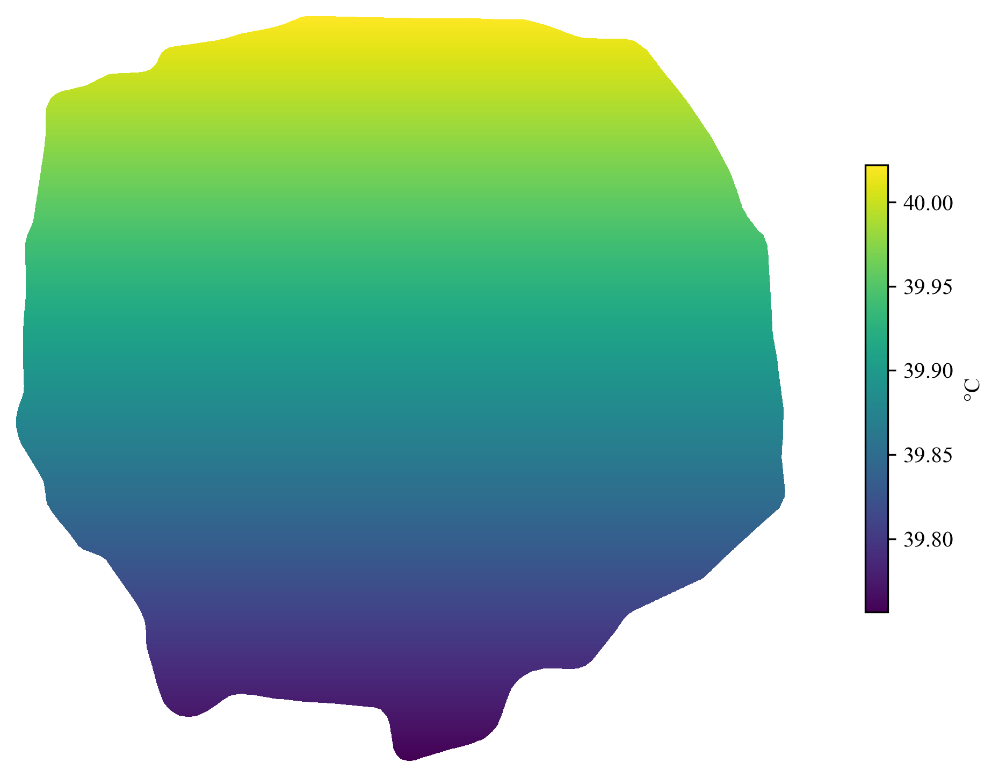

In [67]:
fig, ax = plt.subplots(dpi=300)
lat_dt.plot(ax=ax,
            cbar_kwargs={'shrink': 0.6, 'label': '°C', 'pad': 0.08}
           )
ax.axis('off')
ax.set_title('')
plt.savefig(f'./SavedFig3/latlng.png', bbox_inches='tight',dpi=300)

# same_size

In [29]:
lc.shape, tmp.shape, ndvi.shape, lat_dt.shape, dem.shape, 

((1, 2954, 3807),
 (1, 2953, 3807),
 (1, 2953, 3807),
 (1, 2953, 3807),
 (1, 2953, 3808))

In [30]:
lc = lc[:,:2953,:3807]
tmp = tmp[:,:2953,:3807]
ndvi = ndvi[:,:2953,:3807]
lat_dt = lat_dt[:,:2953,:3807]
dem = dem[:,:2953,:3807]

In [31]:
lc.shape, tmp.shape, ndvi.shape, lat_dt.shape, dem.shape, 

((1, 2953, 3807),
 (1, 2953, 3807),
 (1, 2953, 3807),
 (1, 2953, 3807),
 (1, 2953, 3807))

In [32]:
lc

<xarray.DataArray (band: 1, y: 2953, x: 3807)> Size: 90MB
array([[[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]])
Coordinates:
  * x            (x) float64 30kB 116.2 116.2 116.2 116.2 ... 116.5 116.5 116.5
  * y            (y) float64 24kB 40.02 40.02 40.02 40.02 ... 39.76 39.76 39.76
  * band         (band) int64 8B 1
    spatial_ref  int64 8B 0
Attributes:
    AREA_OR_POINT:  Area
    scale_factor:   1.0
    add_offset:     0.0
    _FillValue:     0

In [33]:
data_ar = np.concatenate([dem.data, tmp.data, lat_dt.data, ndvi.data, lc.data], axis=0)

In [34]:
data_ar.shape

(5, 2953, 3807)

In [35]:
coords = tmp.coords
coordsx = {
    'band': range(1, 6),
    'x': coords['x'],
    'y': coords['y']
}
data_ra = xr.DataArray(data_ar, dims=["band", "y", "x"], coords=coordsx)
data_ra = data_ra.rio.write_crs("4326")

# infer

In [36]:
model = joblib.load('./MODEL/xgboost_with_lc.joblib')

In [37]:
model.predict([[1,1,1,1,1]])

array([19.980469], dtype=float32)

In [38]:
sample_ar = data_ar[:,1200:1300,1200:1300]

In [39]:
# sample_ar

In [40]:
%%time

# 定义一个函数，例如计算每个位置的最大值
def my_function(data):
    data = np.array(data).reshape(1, 5)
    try:
        utci = model.predict(arr)
        print(utci)
    except:
        utci = np.nan
    return utci

# 应用函数
result = np.apply_along_axis(my_function, axis=0, arr=sample_ar)

# 检查结果的形状
print(result.shape)  # 输出: (2953, 3807)

(100, 100)
CPU times: user 9.37 ms, sys: 240 μs, total: 9.61 ms
Wall time: 9.57 ms


In [41]:
sample_ra = data_ra[:,1200:1300,1200:1300]

In [42]:
######################################################

In [46]:
%%time

def cal_UTCI(data):
    data = np.array(data).reshape(1, 5)

    try:
        utci = model.predict(data)
        # print(utci)
    except Exception as e:
        # print(e)
        utci = np.nan
    
    return utci

# result_p = xr.apply_ufunc(cal_UTCI,
#                           data_ra,
#                           input_core_dims=[['band']], vectorize=True)

CPU times: user 1e+03 ns, sys: 1e+03 ns, total: 2 μs
Wall time: 10 μs


In [47]:
# result_p.plot()

In [48]:
# result_px.shape

In [49]:
# 2953 * 3807

# result_px

# from geocube.vector import vectorize

# grid_gdf = vectorize(result_px.astype("float32"))

# grid_gdf

# joblib.dump(result_px, './UTCI/utci.joblib')
# result_px.rio.to_raster('./UTCI/utci.tif')

In [50]:
######################################################

In [51]:
result_px = rx.open_rasterio('./UTCI/utci.tif')

In [52]:
result_px = result_px.rio.clip(region.geometry)

In [53]:
ring2 = gpd.read_file('./边界数据/北京六环/二环.shp')
ring3 = gpd.read_file('./边界数据/北京六环/三环.shp')
ring4 = gpd.read_file('./边界数据/北京六环/四环.shp')
ring5 = gpd.read_file('./边界数据/北京六环/五环.shp')

ring2 = ring2.to_crs(4326)
ring3 = ring3.to_crs(4326)
ring4 = ring4.to_crs(4326)



In [54]:
center_l = gpd.read_file('./边界数据/POLYLINE/')

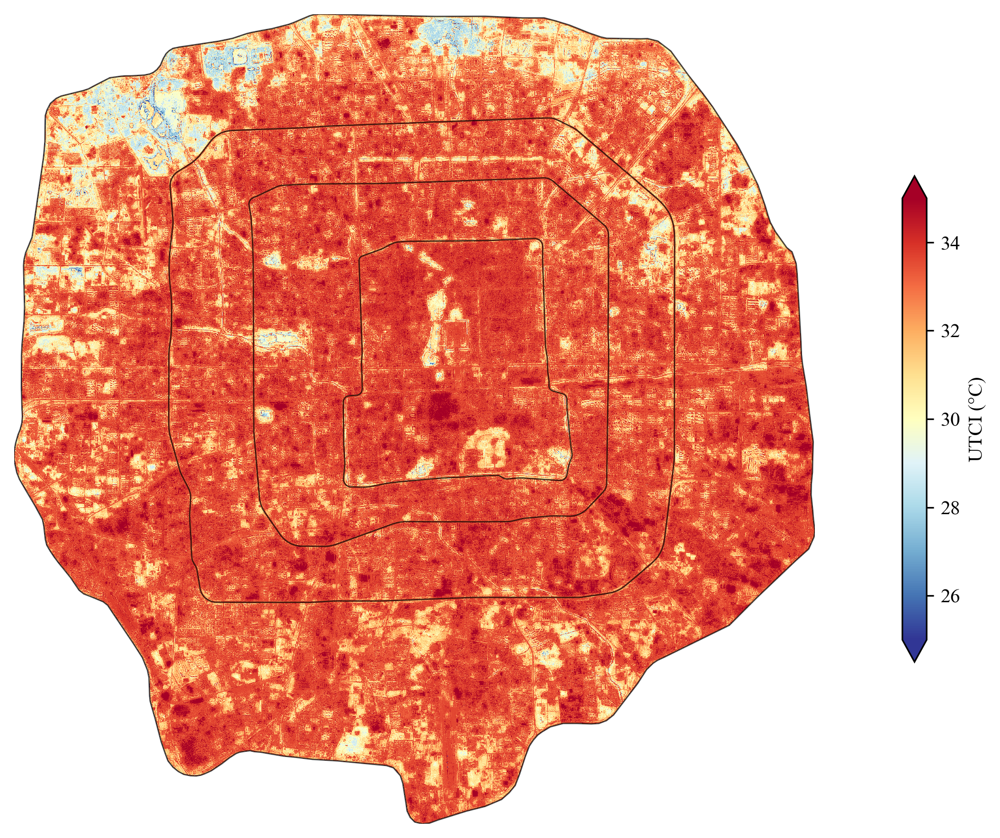

In [56]:
import northarrow_new

fig, ax = plt.subplots(dpi=300)

result_px.plot(vmin=25, vmax=35, cmap='RdYlBu_r', ax=ax,
              cbar_kwargs={'shrink': 0.6, 'label': 'UTCI (°C)', 'pad': 0.08}
              )
lw = 0.7
alpha = 0.7
region.plot(ax=ax,facecolor='none', edgecolor='k', alpha=alpha, lw=lw)
ring2.plot(ax=ax,facecolor='none', edgecolor='k', alpha=alpha, lw=lw)
ring3.plot(ax=ax,facecolor='none', edgecolor='k', alpha=alpha, lw=lw)
ring4.plot(ax=ax,facecolor='none', edgecolor='k', alpha=alpha, lw=lw)
# center_l.plot(ax=ax,edgecolor='k', ls='--',alpha=alpha, lw=lw)
# northarrow_new.add_scalebar_geo2(gdf_geo=region, length=2500, lng=116.51, lat=40-0.007, ax=ax,
#                                 sub=8, divd=6, lw=0.5
#                                 )
ax.axis('off')
ax.set_title('')
plt.tight_layout()
# plt.savefig(f'./SavedFig3/UTCI.png', bbox_inches='tight',dpi=300)

In [57]:
vx = [i for i in result_px.values.flatten() if ~np.isnan(i)]

In [58]:
vx[0]

np.float32(22.467674)

In [59]:
dxx = pd.DataFrame(
    {"utci" : vx}
)

In [60]:
dmean = dxx['utci'].mean().round(3)
dmedian = dxx['utci'].median()
dmax = dxx['utci'].max()
dmin = dxx['utci'].min()

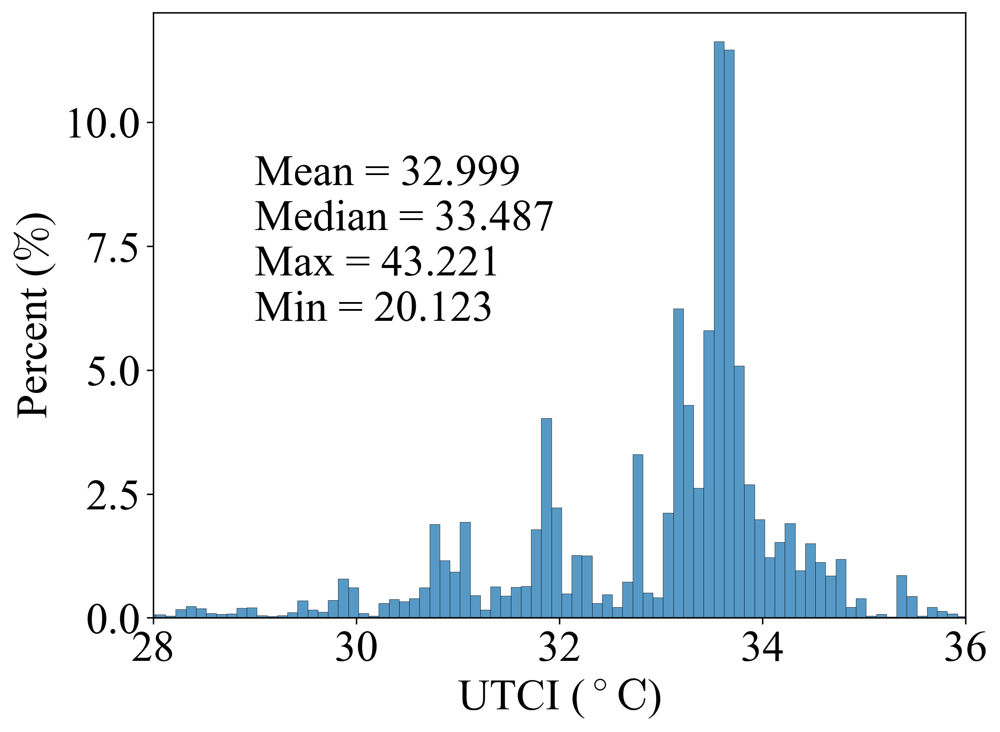

In [61]:
import seaborn as sns

fig, ax = plt.subplots()
sns.histplot(data=dxx, x='utci', stat='percent',binwidth=0.1, ax=ax)
ax.set_xlim(28,36)

fontsize = 24
ax.tick_params(axis='both', labelsize=fontsize)  # 设置 X 轴刻度标签的字体大小为 14 点
ax.set_xlabel("UTCI ($^\circ\mathrm{C}$)", fontsize=fontsize, math_fontfamily='cm', )
ax.set_ylabel("Percent ($\%$)", fontsize=fontsize, math_fontfamily='cm', )

ax.text(29,6,f'Mean = {dmean:.3f}\nMedian = {dmedian:.3f}\nMax = {dmax:.3f}\nMin = {dmin:.3f}',
        math_fontfamily='cm', fontsize=fontsize )

# plt.savefig(f'./SavedFig/01-beijing-utci-hist-raster.png', bbox_inches='tight',dpi=300)
plt.show()